In [ ]:
row_num = 9 # 9, 50, 2, 7, 11, 13, 33
words = tokenizer.sequences_to_texts(Xwords_test[[row_num]])[0].split()
colors = colorize(attrs[0, row_num])

<ipython-input-99-6faf338aa0bf>:18: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed two minor releases later. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap(obj)`` instead.
  cmap = mpl.cm.get_cmap(cmap)


In [ ]:
print('Predicted label =  {}: {}'.format(y_nums_test.iloc[row_num], y_seq_test.iloc[row_num]))

Predicted label =  1: dementia


In [ ]:
HTML("".join(list(map(hlstr, words, colors))))

# Thesis Notebook Part II

## Imports/Setup

In [ ]:
from keras.models import Sequential
from keras.layers import Embedding, Dropout,Conv1D, Flatten, MaxPooling1D, Dense, LSTM,Conv1D,MaxPooling1D, Bidirectional
# from keras.preprocessing.text import Tokenizer
from keras.utils import pad_sequences
# from keras.constraints import maxnorm
from keras.preprocessing import sequence
from keras.callbacks import History
# from keras.preprocessing.text import Tokenizer

from nltk.stem import WordNetLemmatizer
from nltk.tokenize import word_tokenize

# from tensorflow.keras.preprocessing.text import Tokenizer
# from tensorflow.keras.preprocessing.sequence import pad_sequences

import numpy as np
import matplotlib.pyplot as plt
%matplotlib inline

In [ ]:
import tensorflow as tf

In [ ]:
from nltk.corpus import stopwords
from gensim import utils
from sklearn.model_selection import train_test_split
from sklearn import linear_model
from sklearn.feature_extraction.text import CountVectorizer, TfidfVectorizer
from sklearn.metrics import accuracy_score, confusion_matrix

In [ ]:
from gensim.models import Doc2Vec
from gensim.models.doc2vec import TaggedDocument
import nltk
nltk.download('punkt')

[nltk_data] Downloading package punkt to /root/nltk_data...
[nltk_data]   Package punkt is already up-to-date!


True

In [ ]:
from tensorflow.keras.preprocessing.text import Tokenizer
from tensorflow.keras.preprocessing.sequence import pad_sequences
import numpy as np

In [ ]:
import pandas as pd

In [ ]:
talk_bank_small = pd.read_csv("talk_bank_cookie.csv")

In [ ]:
# talk_bank_small = talk_bank_small[talk_bank_small['text'].notna()]

In [ ]:
# part_1 = talk_bank[talk_bank.label == 'dementia'].sample(frac = 0.35)

In [ ]:
# part_2 = talk_bank[talk_bank.label == 'control'].sample(frac = 1.0)

In [ ]:
# talk_bank_small = pd.concat([part_1, part_2], axis = 0)

In [ ]:
# talk_bank_small.to_csv("C:\\Users\\cobus\\Desktop\\Thesis\\talk_bank_small.csv")

In [ ]:
# talk_bank_small = pd.read_csv("talk_bank_small.csv")

## Section One:

### DOC2VEC

In [ ]:
# Text_INPUT_DIM=100


# text_model=None
# filename='docEmbeddings_5_clean.d2v'
# if os.path.isfile(filename):
#     text_model = Doc2Vec.load(filename)
# else:
#     text_model = Doc2Vec(min_count=1, window=5, size=Text_INPUT_DIM, sample=1e-4, negative=5, workers=4, iter=5,seed=1)
#     text_model.build_vocab(sentences)
#     text_model.train(sentences, total_examples=text_model.corpus_count, epochs=text_model.iter)
#     text_model.save(filename

In [ ]:
# tag_d = np.array(train_new.question_text)
# tagged_data = [TaggedDocument(words=word_tokenize(d.lower()),
#                               tags=[str(i)]) for i, d in enumerate(tag_d)]

In [ ]:
# def tokenize_text(text):
#     tokens = []
#     for sent in nltk.sent_tokenize(text):
#         for word in nltk.word_tokenize(sent):
#             if len(word) < 2:
#                 continue
#             tokens.append(word.lower())
#     return tokens

In [ ]:
# def w2v_tokenize_text(text):
#     tokens = []
#     for sent in nltk.sent_tokenize(text):
#         for word in nltk.word_tokenize(sent):
#             if len(word) < 2:
#                 continue
#             tokens.append(word)
#     return tokens

In [ ]:
# train_data, test_data = train_test_split(talk_bank, test_size=0.1, random_state=42)

In [ ]:
# train_tagged = train_data.apply(lambda r: TaggedDocument(words=tokenize_text(talk_bank['text']), tags=[r.tag]), axis=1)
# test_tagged = test_data.apply(lambda r: TaggedDocument(words=tokenize_text(talk_bank['text']), tags=[r.tag]), axis=1)

In [ ]:
# test_tagged.values[50]

In [ ]:
#Splitting data


X_seq_train, X_seq_test, y_seq_train, y_seq_test = train_test_split(talk_bank_small['text'], talk_bank_small['label'], test_size = 0.1, random_state = 100, stratify = talk_bank_small['label'])

# y_nums_train = [int(y =='dementia') for y in y_seq_train]

y_nums_train = (y_seq_train == 'dementia').astype(int)


In [ ]:
from gensim.models.doc2vec import Doc2Vec, TaggedDocument
from nltk.tokenize import word_tokenize
import numpy as np
from keras.preprocessing.text import Tokenizer

# Sample data: list of sentences
documents = X_seq_train
tokenizer = Tokenizer()
tokenizer.fit_on_texts(documents)

def embedding_for_vocab(source_embeddings, word_index,
                        embedding_dim):
    vocab_size = len(word_index) + 1

    # Adding again 1 because of reserved 0 index
    embedding_matrix_vocab = np.zeros((vocab_size + 1000, embedding_dim))

    words_found = 0
    for word, i in word_index.items():
        if word in source_embeddings:
            words_found += 1
            embedding_matrix_vocab[i] = source_embeddings[word]

    print(words_found)
    return embedding_matrix_vocab

# Tokenize the documents and tag them with an index
tagged_data = [
    TaggedDocument(
        words=[tokenizer.index_word[ind] for ind in tokenizer.texts_to_sequences([doc.lower()])[0]],
        tags=[str(i)]
    ) for i, doc in enumerate(documents)
]


model = Doc2Vec(vector_size=500,  # Size of the embedding vector
                window=2,       # Maximum distance between current and predicted word
                min_count=1,    # Ignores all words with total frequency lower than this
                workers=4,      # Number of worker threads to train the model
                dm=0,           # distributed memory mode
                dbow_words=1,   # train word embedding alongside document embeddings
                epochs=40)      # Number of training iterations over the corpus


model.build_vocab(tagged_data)


model.train(tagged_data, total_examples=model.corpus_count, epochs=model.epochs)

# Extracting embeddings (the embedding matrix for all documents)
embedding_matrix = embedding_for_vocab(model.wv, tokenizer.word_index, 500)

# for i in range(len(tagged_data)):
#     embedding_matrix[i] = model.dv[str(i)]  # Use model.dv (document vectors) to get embeddings

# # embedding_matrix now contains the embeddings for each document
# print("Embedding Matrix Shape:", embedding_matrix.shape)

# # To get the embedding of a new document
# new_document = "A completely new sentence to encode"
# new_doc_vector = model.infer_vector(word_tokenize(new_document.lower()))
# print("New Document Vector:", new_doc_vector)


1587


In [ ]:
y_nums_test = (y_seq_test == 'dementia').astype(int)

In [ ]:
# tokenizer = Tokenizer(num_words = 2500)
# tokenizer.fit_on_texts(X_seq_train)

Xwords_train = tokenizer.texts_to_sequences(X_seq_train)
Xwords_test = tokenizer.texts_to_sequences(X_seq_test)

In [ ]:
#Padding the sentence sequences

max_review_length = 500
Xwords_train = pad_sequences(Xwords_train, maxlen=max_review_length)
Xwords_test = pad_sequences(Xwords_test, maxlen=max_review_length)

## LSTM

In [ ]:
history = History()

model = Sequential()
model.add(Embedding(embedding_matrix.shape[0], output_dim = 500, weights = [embedding_matrix], input_length=500, trainable = False))
model.add(LSTM(128, dropout=0.2, recurrent_dropout=0.2))
model.add(Dense(1, activation='sigmoid'))
model.compile(loss='binary_crossentropy', optimizer='adam', metrics=['accuracy'])
print(model.summary())


Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 embedding (Embedding)       (None, 500, 500)          1294000   
                                                                 
 lstm (LSTM)                 (None, 128)               322048    
                                                                 
 dense (Dense)               (None, 1)                 129       
                                                                 
Total params: 1616177 (6.17 MB)
Trainable params: 322177 (1.23 MB)
Non-trainable params: 1294000 (4.94 MB)
_________________________________________________________________
None


In [ ]:
# y_nums_train = tf.keras.utils.to_categorical(y_nums_train)
# y_seq_test = tf.keras.utils.to_categorical(y_seq_test)

In [ ]:
import os
import tensorflow as tf

checkpoint_path = r"doc_lstm"
checkpoint_dir = os.path.dirname(checkpoint_path)

# Create a callback that saves the model's weights
cp_callback = tf.keras.callbacks.ModelCheckpoint(filepath=checkpoint_path, monitor="val_loss", save_best_only=True,
                                                 save_weights_only=True,
                                                 verbose=1)

# Train the model with the new callback
model.fit(Xwords_train, y_nums_train, epochs=45, batch_size=256,verbose = 1,callbacks = [history, cp_callback],validation_split=0.1)  # Pass callback to training


Epoch 1/45
2/2 [==============================] - ETA: 0s - loss: 0.6827 - accuracy: 0.5541 
Epoch 1: val_loss improved from inf to 0.71803, saving model to doc_lstm
2/2 [==============================] - 20s 6s/step - loss: 0.6827 - accuracy: 0.5541 - val_loss: 0.7180 - val_accuracy: 0.5200
Epoch 2/45
2/2 [==============================] - ETA: 0s - loss: 0.6641 - accuracy: 0.5698
Epoch 2: val_loss improved from 0.71803 to 0.69013, saving model to doc_lstm
2/2 [==============================] - 14s 6s/step - loss: 0.6641 - accuracy: 0.5698 - val_loss: 0.6901 - val_accuracy: 0.5600
Epoch 3/45
2/2 [==============================] - ETA: 0s - loss: 0.6345 - accuracy: 0.6847
Epoch 3: val_loss improved from 0.69013 to 0.68505, saving model to doc_lstm
2/2 [==============================] - 15s 7s/step - loss: 0.6345 - accuracy: 0.6847 - val_loss: 0.6850 - val_accuracy: 0.5600
Epoch 4/45
2/2 [==============================] - ETA: 0s - loss: 0.6168 - accuracy: 0.6644
Epoch 4: val_loss did n

In [ ]:
# Loads the weights
model.load_weights(checkpoint_path)

# Re-evaluate the model
loss, acc = model.evaluate(Xwords_test, y_nums_test, verbose=2)
print("Restored model, accuracy: {:5.2f}%".format(100 * acc))

2/2 - 1s - loss: 0.3998 - accuracy: 0.7818 - 1s/epoch - 683ms/step
Restored model, accuracy: 78.18%


In [ ]:
# type(model)

2/2 [==============================] - 1s 217ms/step


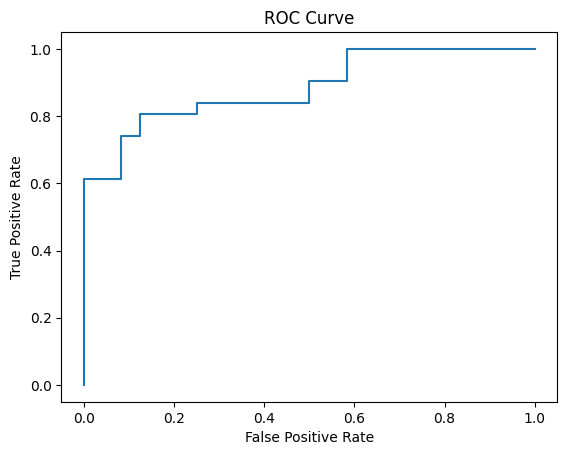

In [ ]:
from sklearn.metrics import roc_curve , roc_auc_score
y_pred_probas = model.predict(Xwords_test)
y_pred_probas = [i[0] for i in y_pred_probas]
fpr, tpr, thresholds = roc_curve(y_seq_test, y_pred_probas, pos_label = 'dementia')
# roc_auc = roc_auc_score(y_test, scores)
plt.plot(fpr, tpr)

plt.title("ROC Curve")

plt.xlabel("False Positive Rate")

plt.ylabel("True Positive Rate")

plt.show()

In [ ]:
#predicting classes on test data
from sklearn.metrics import f1_score
predict_x = model.predict(Xwords_test)

score = []
for theshold in np.arange(0,1,.01):
    classes_x = (predict_x >= theshold).astype(int)
    ideal_score = f1_score(y_nums_test, classes_x)

    score.append(ideal_score)

final = np.argmax(score)
final = final/100
print(final)



2/2 [==============================] - 0s 153ms/step
0.58


In [ ]:
classes_x = (predict_x >= final).astype(int)


In [ ]:
from sklearn.metrics import confusion_matrix
from sklearn.metrics import precision_recall_fscore_support, classification_report

print(confusion_matrix(y_nums_test, classes_x))
print(classification_report(y_nums_test, classes_x))

[[21  3]
 [ 6 25]]
              precision    recall  f1-score   support

           0       0.78      0.88      0.82        24
           1       0.89      0.81      0.85        31

    accuracy                           0.84        55
   macro avg       0.84      0.84      0.84        55
weighted avg       0.84      0.84      0.84        55



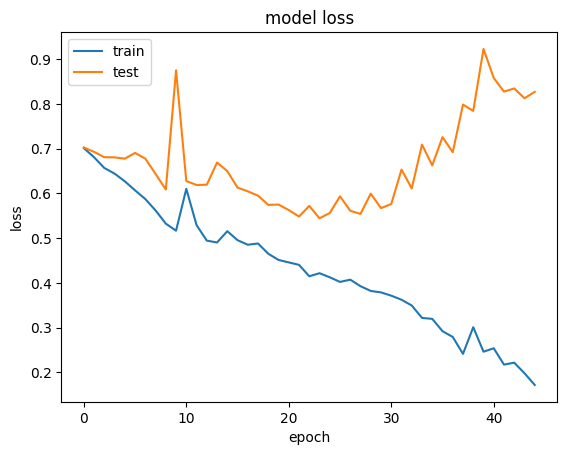

In [ ]:
plt.plot(history.history['loss'])
plt.plot(history.history['val_loss'])
plt.title('model loss')
plt.ylabel('loss')
plt.xlabel('epoch')
plt.legend(['train', 'test'], loc='upper left')
plt.show()

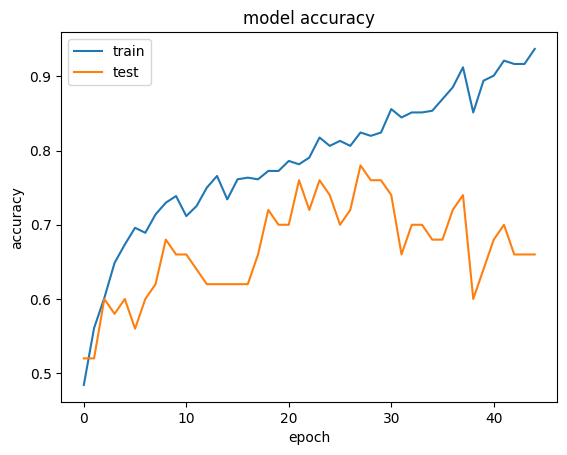

In [ ]:
plt.plot(history.history['accuracy'])
plt.plot(history.history['val_accuracy'])
plt.title('model accuracy')
plt.ylabel('accuracy')
plt.xlabel('epoch')
plt.legend(['train', 'test'], loc='upper left')
plt.show()

In [ ]:
pip install lime

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 275.7/275.7 kB 2.5 MB/s eta 0:00:00
  Preparing metadata (setup.py) ... done
  Created wheel for lime: filename=lime-0.2.0.1-py3-none-any.whl size=283835 sha256=fa05d9702f56fa5fce248150041553c402bf6b8318ed72c66e8d1d944535707f
  Stored in directory: /root/.cache/pip/wheels/fd/a2/af/9ac0a1a85a27f314a06b39e1f492bee1547d52549a4606ed89
Successfully built lime


In [ ]:
from lime.lime_text import LimeTextExplainer
class_names=['control','dementia']
explainer= LimeTextExplainer(class_names=class_names)

def predict_proba(arr):
  list_tokenized_ex = tokenizer.texts_to_sequences(arr)
  seqs = pad_sequences(list_tokenized_ex, maxlen=max_review_length)
  preds = model.predict(seqs)
  returnable = []
  for pred in preds:
    temp = pred[0]
    returnable.append(np.array([1-temp, temp])) #I would recommend rounding temp and 1-temp off to 2 places

  return np.array(returnable)


In [ ]:
# print("Actual text:", X_seq_test.iloc[50])
print("Actual class:", y_seq_test.iloc[50])

explainer.explain_instance(X_seq_test.iloc[50], predict_proba).show_in_notebook(text=True)

Actual class: control
157/157 [==============================] - 45s 289ms/step


In [ ]:
# print("Actual text:", X_seq_test.iloc[2])
print("Actual class:", y_seq_test.iloc[2])

explainer.explain_instance(X_seq_test.iloc[2], predict_proba).show_in_notebook(text=True)

Actual class: control
157/157 [==============================] - 23s 146ms/step


In [ ]:
# print("Actual text:", X_seq_test.iloc[7])
print("Actual class:", y_seq_test.iloc[7])

explainer.explain_instance(X_seq_test.iloc[7], predict_proba).show_in_notebook(text=True)

Actual class: dementia
157/157 [==============================] - 26s 166ms/step


In [ ]:
print("Actual text:", X_seq_test.iloc[11])
print("Actual class:", y_seq_test.iloc[11])

explainer.explain_instance(X_seq_test.iloc[11], predict_proba).show_in_notebook(text=True)

Actual text: now honey i had it was in the kitchen and i was the . and if we made a mess like that you'd get a kick in the ass . well we have uh spilling of the water . and a kid with his cookie jar . and a stool is turned over . and a mother's running the water on the floor . and what else do you want from that . it looks like somebody's laying out in the grass doesn't it . and a kid in the cookie jar . and a tilted stool . what more do you want . the the water rolling on the floor .
Actual class: dementia
157/157 [==============================] - 25s 161ms/step


In [ ]:
print("Actual text:", X_seq_test.iloc[7])
print("Actual class:", y_seq_test.iloc[7])

explainer.explain_instance(X_seq_test.iloc[7], predict_proba).as_map()

Actual text: oh you want me to tell you . the mother and her two children . and the children are getting in the cookie jar . and she's doing the dishes and spilling the water . and she had the spigot on . and she didn't know it perhaps . pardon me . and they're looking out into the garden from the kitchen window . it's open . and the uh cookies must be pretty good they're eating . the tair uh the chair . and uh the lady the mother's splashing her shoes and . and there's um uh a window and curtains on the window . and i can see some trees outside there . and and there's dishes that had been washed . and she's drying them . and there's some shrub out there and .
Actual class: dementia


{1: [(40, -0.12552805915391527),
  (61, 0.09417966573846853),
  (8, 0.09253703905058751),
  (54, 0.049728746350582234),
  (41, -0.046064330154323194),
  (37, -0.037140565690954704),
  (57, -0.03637788549330808),
  (62, -0.030619669923949544),
  (9, -0.02963651122140742),
  (42, 0.023940963328369008)]}

In [ ]:
# import shap
# # we use the first 100 training examples as our background dataset to integrate over
# explainer = shap.DeepExplainer(model, Xwords_train[:100])

# # explain the first 10 predictions
# # explaining each prediction requires 2 * background dataset size runs
# shap_values = explainer.shap_values(Xwords_test[:10])

## Bidrectional LSTM

In [ ]:

history = History()
model_bilstm = Sequential()
model_bilstm.add(Embedding(embedding_matrix.shape[0], output_dim = 100, weights = [embedding_matrix], input_length=100, trainable = False))
model_bilstm.add(Bidirectional(LSTM(128, recurrent_dropout=0.2)))
model_bilstm.add(Dense(1, activation='sigmoid'))
model_bilstm.compile(loss='binary_crossentropy', optimizer='adam', metrics=['accuracy'])
print(model_bilstm.summary())


Instructions for updating:
Call initializer instance with the dtype argument instead of passing it to the constructor
Instructions for updating:
Call initializer instance with the dtype argument instead of passing it to the constructor
Instructions for updating:
Call initializer instance with the dtype argument instead of passing it to the constructor
Model: "sequential_1"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 embedding_1 (Embedding)     (None, 100, 100)          258800    
                                                                 
 bidirectional (Bidirectiona  (None, 256)              234496    
 l)                                                              
                                                                 
 dense_1 (Dense)             (None, 1)                 257       
                                                                 
Total params: 493,553
Trainabl

In [ ]:
import os
import tensorflow as tf

checkpoint_path = r"doc_bilstm"
checkpoint_dir = os.path.dirname(checkpoint_path)


# Create a callback that saves the model's weights
cp_callback = tf.keras.callbacks.ModelCheckpoint(filepath=checkpoint_path, monitor="val_loss", save_best_only=True,
                                                 save_weights_only=True,
                                                 verbose=1)

# Train the model with the new callback
model_bilstm.fit(Xwords_train, y_nums_train, epochs=45, batch_size=256,verbose = 1,callbacks = [history, cp_callback],validation_split=0.1)  # Pass callback to training


Train on 444 samples, validate on 50 samples
Epoch 1/45
444/444 [==============================] - ETA: 0s - loss: 0.6840 - acc: 0.5676

C:\Users\cobus\AppData\Roaming\Python\Python39\site-packages\keras\engine\training_v1.py:2335: UserWarning: `Model.state_updates` will be removed in a future version. This property should not be used in TensorFlow 2.0, as `updates` are applied automatically.
  updates = self.state_updates



Epoch 1: val_loss improved from inf to 0.69308, saving model to doc_bilstm
444/444 [==============================] - 4s 10ms/sample - loss: 0.6840 - acc: 0.5676 - val_loss: 0.6931 - val_acc: 0.5200
Epoch 2/45
444/444 [==============================] - ETA: 0s - loss: 0.6640 - acc: 0.5766
Epoch 2: val_loss improved from 0.69308 to 0.68660, saving model to doc_bilstm
444/444 [==============================] - 3s 6ms/sample - loss: 0.6640 - acc: 0.5766 - val_loss: 0.6866 - val_acc: 0.5600
Epoch 3/45
444/444 [==============================] - ETA: 0s - loss: 0.6446 - acc: 0.6306
Epoch 3: val_loss improved from 0.68660 to 0.68046, saving model to doc_bilstm
444/444 [==============================] - 3s 7ms/sample - loss: 0.6446 - acc: 0.6306 - val_loss: 0.6805 - val_acc: 0.5800
Epoch 4/45
444/444 [==============================] - ETA: 0s - loss: 0.6245 - acc: 0.6712
Epoch 4: val_loss improved from 0.68046 to 0.67537, saving model to doc_bilstm
444/444 [==============================] - 3

In [ ]:
# Loads the weights
model_bilstm.load_weights(checkpoint_path)

# Re-evaluate the model
loss, acc = model_bilstm.evaluate(Xwords_test, y_nums_test, verbose=2)
print("Restored model, accuracy: {:5.2f}%".format(100 * acc))

2/2 - 0s - loss: 0.3335 - accuracy: 0.8909 - 128ms/epoch - 64ms/step
Restored model, accuracy: 89.09%


C:\Users\cobus\AppData\Roaming\Python\Python39\site-packages\keras\engine\training_v1.py:2359: UserWarning: `Model.state_updates` will be removed in a future version. This property should not be used in TensorFlow 2.0, as `updates` are applied automatically.
  updates=self.state_updates,


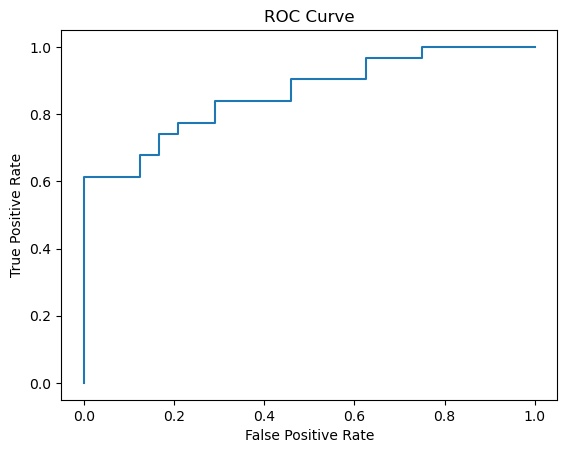

In [ ]:
from sklearn.metrics import roc_curve , roc_auc_score
y_pred_probas = model_bilstm.predict(Xwords_test)
y_pred_probas = [i[0] for i in y_pred_probas]
fpr, tpr, thresholds = roc_curve(y_seq_test, y_pred_probas, pos_label = 'dementia')
#roc_auc = roc_auc_score(y_test, scores)
plt.plot(fpr, tpr)

plt.title("ROC Curve")

plt.xlabel("False Positive Rate")

plt.ylabel("True Positive Rate")

plt.show()

In [ ]:
#predicting classes on test data
from sklearn.metrics import f1_score
predict_x=model_bilstm.predict(Xwords_test)

score = []
for theshold in np.arange(0,1,.01):
    classes_x= (predict_x >= theshold).astype(int)
    ideal_score = f1_score(y_nums_test, classes_x)

    score.append(ideal_score)

final = np.argmax(score)

print(final)


36


In [ ]:
final = final/100
classes_x = (predict_x >= final).astype(int)

In [ ]:
from sklearn.metrics import confusion_matrix
from sklearn.metrics import precision_recall_fscore_support, classification_report

print(confusion_matrix(y_nums_test, classes_x))
print(classification_report(y_nums_test, classes_x))

[[17  7]
 [ 5 26]]
              precision    recall  f1-score   support

           0       0.77      0.71      0.74        24
           1       0.79      0.84      0.81        31

    accuracy                           0.78        55
   macro avg       0.78      0.77      0.78        55
weighted avg       0.78      0.78      0.78        55



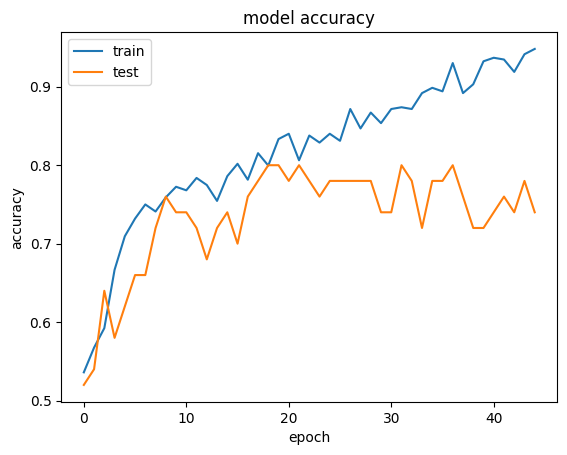

In [ ]:
plt.plot(history.history['accuracy'])
plt.plot(history.history['val_accuracy'])
plt.title('model accuracy')
plt.ylabel('accuracy')
plt.xlabel('epoch')
plt.legend(['train', 'test'], loc='upper left')
plt.show()

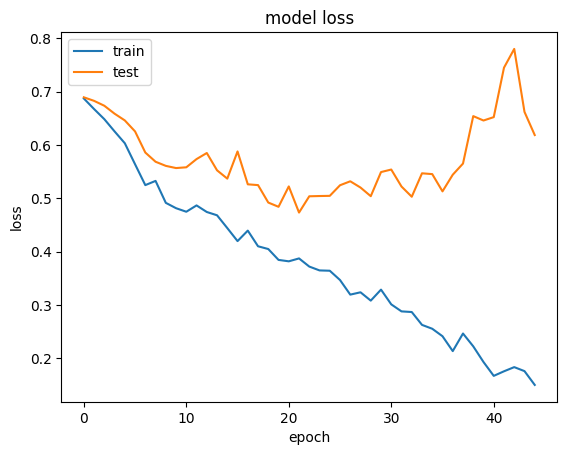

In [ ]:
plt.plot(history.history['loss'])
plt.plot(history.history['val_loss'])
plt.title('model loss')
plt.ylabel('loss')
plt.xlabel('epoch')
plt.legend(['train', 'test'], loc='upper left')
plt.show()

In [ ]:
from lime.lime_text import LimeTextExplainer
class_names=['control','dementia']
explainer= LimeTextExplainer(class_names=class_names)

def predict_proba(arr):
  list_tokenized_ex = tokenizer.texts_to_sequences(arr)
  seqs = pad_sequences(list_tokenized_ex, maxlen=max_review_length)
  preds = model_bilstm.predict(seqs)
  returnable = []
  for pred in preds:
    temp = pred[0]
    returnable.append(np.array([1-temp, temp]))

  return np.array(returnable)


In [ ]:

print("Actual class:", y_seq_test.iloc[50])

explainer.explain_instance(X_seq_test.iloc[50], predict_proba).show_in_notebook(text=True)

Actual class: control


In [ ]:

print("Actual class:", y_seq_test.iloc[2])

explainer.explain_instance(X_seq_test.iloc[2], predict_proba).show_in_notebook(text=True)

Actual class: control


In [ ]:

print("Actual class:", y_seq_test.iloc[7])

explainer.explain_instance(X_seq_test.iloc[7], predict_proba).show_in_notebook(text=True)

Actual class: dementia


In [ ]:

print("Actual class:", y_seq_test.iloc[11])

explainer.explain_instance(X_seq_test.iloc[11], predict_proba).show_in_notebook(text=True)

Actual class: dementia


## CNN LSTM

In [ ]:
history = History()
def create_conv_model():
    model_conv = Sequential()
    model_conv.add(Embedding(input_dim = embedding_matrix.shape[0], output_dim = 100, weights = [embedding_matrix], input_length=100, trainable = False))
    model_conv.add(Dropout(0.1))
    model_conv.add(Conv1D(32, 5, activation='relu'))
    model_conv.add(MaxPooling1D(pool_size=4))
    model_conv.add(LSTM(64))
    model_conv.add(Dense(1, activation='sigmoid'))
    model_conv.compile(loss='binary_crossentropy', optimizer='adam',metrics=['accuracy'])
    return model_conv

In [ ]:
import os
import tensorflow as tf

checkpoint_path = r"doc_cnnlstm"
checkpoint_dir = os.path.dirname(checkpoint_path)

# Create a callback that saves the model's weights
cp_callback = tf.keras.callbacks.ModelCheckpoint(filepath=checkpoint_path, monitor="val_loss", save_best_only=True,
                                                 save_weights_only=True,
                                                 verbose=1)

# Train the model with the new callback

model_conv1 = create_conv_model()
# model_conv1.fit(Xwords_train, y_nums_train, epochs=45, batch_size=256,verbose = 1,callbacks = [history, cp_callback],validation_split=0.1)  # Pass callback to training



In [ ]:
# Loads the weights
model_conv1.load_weights(checkpoint_path)

# Re-evaluate the model
loss, acc = model_conv1.evaluate(Xwords_test, y_nums_test, verbose=2)
print("Restored model, accuracy: {:5.2f}%".format(100 * acc))

2/2 - 0s - loss: 0.3351 - accuracy: 0.8545 - 23ms/epoch - 11ms/step
Restored model, accuracy: 85.45%


C:\Users\cobus\AppData\Roaming\Python\Python39\site-packages\keras\engine\training_v1.py:2359: UserWarning: `Model.state_updates` will be removed in a future version. This property should not be used in TensorFlow 2.0, as `updates` are applied automatically.
  updates=self.state_updates,


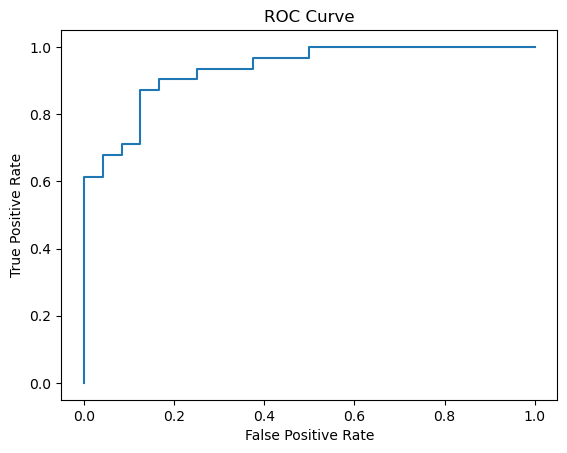

In [ ]:
from sklearn.metrics import roc_curve , roc_auc_score
y_pred_probas = model_conv1.predict(Xwords_test)
y_pred_probas = [i[0] for i in y_pred_probas]
fpr, tpr, thresholds = roc_curve(y_seq_test, y_pred_probas, pos_label = 'dementia')
#roc_auc = roc_auc_score(y_test, scores)
plt.plot(fpr, tpr)

plt.title("ROC Curve")

plt.xlabel("False Positive Rate")

plt.ylabel("True Positive Rate")

plt.show()

In [ ]:
#predicting classes on test data
from sklearn.metrics import f1_score
predict_x=model_conv1.predict(Xwords_test)

score = []
for theshold in np.arange(0,1,.01):
    classes_x= (predict_x >= theshold).astype(int)
    ideal_score = f1_score(y_nums_test, classes_x)

    score.append(ideal_score)

final = np.argmax(score)

print(final)


80


In [ ]:
final = final/100
classes_x = (predict_x >= final).astype(int)

In [ ]:
from sklearn.metrics import confusion_matrix
from sklearn.metrics import precision_recall_fscore_support, classification_report

print(confusion_matrix(y_nums_test, classes_x))
print(classification_report(y_nums_test, classes_x))

[[20  4]
 [ 3 28]]
              precision    recall  f1-score   support

           0       0.87      0.83      0.85        24
           1       0.88      0.90      0.89        31

    accuracy                           0.87        55
   macro avg       0.87      0.87      0.87        55
weighted avg       0.87      0.87      0.87        55



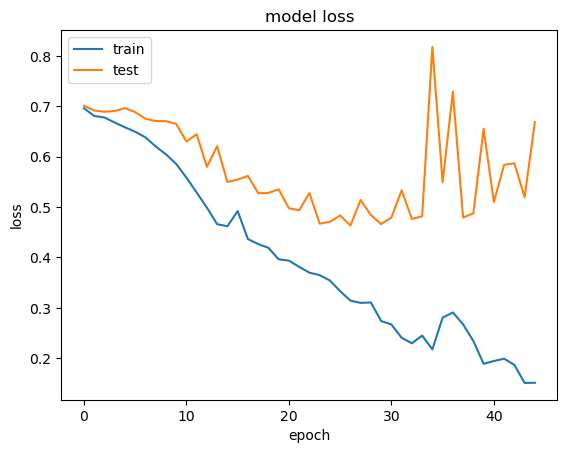

In [ ]:
plt.plot(history.history['loss'])
plt.plot(history.history['val_loss'])
plt.title('model loss')
plt.ylabel('loss')
plt.xlabel('epoch')
plt.legend(['train', 'test'], loc='upper left')
plt.show()

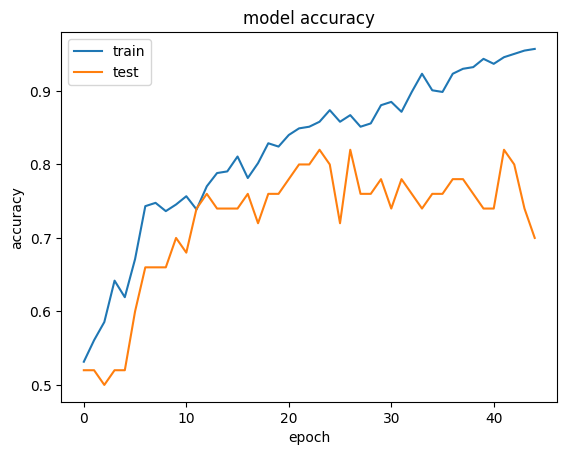

In [ ]:
plt.plot(history.history['accuracy'])
plt.plot(history.history['val_accuracy'])
plt.title('model accuracy')
plt.ylabel('accuracy')
plt.xlabel('epoch')
plt.legend(['train', 'test'], loc='upper left')
plt.show()

## SECTION TWO: BERT

### input embeddings


In [ ]:
import numpy as np
import pandas as pd
import os
from tqdm import tqdm, trange
from sklearn.metrics import roc_auc_score
import pickle
import gc

In [ ]:
from transformers import BertModel, BertTokenizer

In [ ]:
BERT_MODEL = 'bert-base-uncased'
INPUT = r"C:\Users\cobus\Desktop\Thesis\talk_bank_small.csv"
TEXT_COL = talk_bank_small['text']
MAXLEN = 250

In [ ]:
#Splitting data
X_seq_train, X_seq_test, y_seq_train, y_seq_test = train_test_split(talk_bank_small['text'], talk_bank_small['label'], test_size = 0.1, random_state = 100, stratify = talk_bank_small['label'])

In [ ]:
sentences = X_seq_train

In [ ]:
tokenizer = BertTokenizer.from_pretrained(BERT_MODEL)

In [ ]:
def tokenize(sentences):
    input_ids = []
    attention_masks = []

    # For every sentence...
    for sent in sentences:
        encoded_dict = tokenizer.encode_plus(
                sent,                      # Sentence to split into tokens
                add_special_tokens = True, # Add special token '[CLS]' and '[SEP]'
                # max_length = 100,           # Pad & truncate all sentences.
                padding = 'longest',
                return_attention_mask = True,   # Construct attention masks.
                return_tensors = 'pt',     # Return pytorch tensors.
            )

        # adding the encoded sentence to the list.
        tensor = encoded_dict['input_ids']
        input_ids.append(encoded_dict['input_ids'].reshape((-1,)).detach().numpy())

        # attention mask (to differentiate padding from non-padding).
        attention_masks.append(encoded_dict['attention_mask'])

    return input_ids

In [ ]:
input_ids = tokenize(X_seq_train)
test_ids = tokenize(X_seq_test)

Token indices sequence length is longer than the specified maximum sequence length for this model (530 > 512). Running this sequence through the model will result in indexing errors


In [ ]:
input_ids = pad_sequences(input_ids, maxlen=250)
test_ids = pad_sequences(test_ids, maxlen=250)

In [ ]:
model = BertModel.from_pretrained(BERT_MODEL)

Some weights of the model checkpoint at bert-base-uncased were not used when initializing BertModel: ['cls.seq_relationship.bias', 'cls.predictions.transform.LayerNorm.bias', 'cls.predictions.bias', 'cls.predictions.transform.LayerNorm.weight', 'cls.seq_relationship.weight', 'cls.predictions.transform.dense.weight', 'cls.predictions.transform.dense.bias', 'cls.predictions.decoder.weight']
- This IS expected if you are initializing BertModel from the checkpoint of a model trained on another task or with another architecture (e.g. initializing a BertForSequenceClassification model from a BertForPreTraining model).
- This IS NOT expected if you are initializing BertModel from the checkpoint of a model that you expect to be exactly identical (initializing a BertForSequenceClassification model from a BertForSequenceClassification model).


In [ ]:
input_embeddings = model.get_input_embeddings()

In [ ]:
import torch
print(input_embeddings(torch.tensor(input_ids[0])).shape)
print(input_ids[0].shape)

torch.Size([250, 768])
(250,)


In [ ]:
# dir(input_embeddings)
parameters = next(input_embeddings.parameters())
embedding_matrix = parameters.detach().numpy()
embedding_matrix.shape

(30522, 768)

In [ ]:

# y_nums_train = [int(y =='dementia') for y in y_seq_train]

y_nums_train = (y_seq_train == 'dementia').astype(int)
y_nums_test = (y_seq_test == 'dementia').astype(int)

## LSTM with BERT Embeddings

In [ ]:
history = History()

model = Sequential()
model.add(Embedding(input_dim = tokenizer.vocab_size, output_dim = 768, weights = [embedding_matrix], input_length=250, trainable = False))
model.add(LSTM(128, dropout=0.2, recurrent_dropout=0.2))
model.add(Dense(1, activation='sigmoid'))
model.compile(loss='binary_crossentropy', optimizer='adam', metrics=['accuracy'])
print(model.summary())

Model: "sequential_10"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 embedding_10 (Embedding)    (None, 250, 768)          23440896  
                                                                 
 lstm_10 (LSTM)              (None, 128)               459264    
                                                                 
 dense_10 (Dense)            (None, 1)                 129       
                                                                 
Total params: 23,900,289
Trainable params: 459,393
Non-trainable params: 23,440,896
_________________________________________________________________
None


In [ ]:
Xwords_train = input_ids
Xwords_test = test_ids

In [ ]:
import os
import tensorflow as tf

checkpoint_path = r"bert_lstm"
checkpoint_dir = os.path.dirname(checkpoint_path)

# Create a callback that saves the model's weights
cp_callback = tf.keras.callbacks.ModelCheckpoint(filepath=checkpoint_path,
                                                 monitor="val_loss",
                                                 save_best_only=True,
                                                 save_weights_only=True,
                                                 verbose=1)

# Train the model with the new callback
model.fit(Xwords_train, y_nums_train, epochs=45, batch_size=256,verbose = 1,callbacks = [history, cp_callback],validation_split=0.1)  # Pass callback to training


Train on 444 samples, validate on 50 samples
Epoch 1/45
444/444 [==============================] - ETA: 0s - loss: 0.6902 - acc: 0.5023

C:\Users\cobus\AppData\Roaming\Python\Python39\site-packages\keras\engine\training_v1.py:2335: UserWarning: `Model.state_updates` will be removed in a future version. This property should not be used in TensorFlow 2.0, as `updates` are applied automatically.
  updates = self.state_updates



Epoch 1: val_loss improved from inf to 0.69713, saving model to bert_lstm
444/444 [==============================] - 12s 28ms/sample - loss: 0.6902 - acc: 0.5023 - val_loss: 0.6971 - val_acc: 0.5200
Epoch 2/45
444/444 [==============================] - ETA: 0s - loss: 0.6844 - acc: 0.5608
Epoch 2: val_loss did not improve from 0.69713
444/444 [==============================] - 11s 26ms/sample - loss: 0.6844 - acc: 0.5608 - val_loss: 0.7028 - val_acc: 0.5200
Epoch 3/45
444/444 [==============================] - ETA: 0s - loss: 0.6835 - acc: 0.5608
Epoch 3: val_loss improved from 0.69713 to 0.69282, saving model to bert_lstm
444/444 [==============================] - 14s 31ms/sample - loss: 0.6835 - acc: 0.5608 - val_loss: 0.6928 - val_acc: 0.5200
Epoch 4/45
444/444 [==============================] - ETA: 0s - loss: 0.6781 - acc: 0.5608
Epoch 4: val_loss improved from 0.69282 to 0.68731, saving model to bert_lstm
444/444 [==============================] - 13s 29ms/sample - loss: 0.6781 

Epoch 31/45
444/444 [==============================] - ETA: 0s - loss: 0.5090 - acc: 0.7500
Epoch 31: val_loss did not improve from 0.58464
444/444 [==============================] - 17s 38ms/sample - loss: 0.5090 - acc: 0.7500 - val_loss: 0.6610 - val_acc: 0.6800
Epoch 32/45
444/444 [==============================] - ETA: 0s - loss: 0.5156 - acc: 0.7838
Epoch 32: val_loss did not improve from 0.58464
444/444 [==============================] - 17s 39ms/sample - loss: 0.5156 - acc: 0.7838 - val_loss: 0.6842 - val_acc: 0.6000
Epoch 33/45
444/444 [==============================] - ETA: 0s - loss: 0.5176 - acc: 0.7748
Epoch 33: val_loss did not improve from 0.58464
444/444 [==============================] - 17s 38ms/sample - loss: 0.5176 - acc: 0.7748 - val_loss: 0.6914 - val_acc: 0.6400
Epoch 34/45
444/444 [==============================] - ETA: 0s - loss: 0.5059 - acc: 0.7568
Epoch 34: val_loss did not improve from 0.58464
444/444 [==============================] - 17s 37ms/sample - loss

In [ ]:
# Loads the weights
model.load_weights(checkpoint_path)

# Re-evaluate the model
loss, acc = model.evaluate(Xwords_test, y_nums_test, verbose=2)
print("Restored model, accuracy: {:5.2f}%".format(100 * acc))

2/2 - 0s - loss: 0.5640 - accuracy: 0.7091 - 155ms/epoch - 78ms/step
Restored model, accuracy: 70.91%


C:\Users\cobus\AppData\Roaming\Python\Python39\site-packages\keras\engine\training_v1.py:2359: UserWarning: `Model.state_updates` will be removed in a future version. This property should not be used in TensorFlow 2.0, as `updates` are applied automatically.
  updates=self.state_updates,


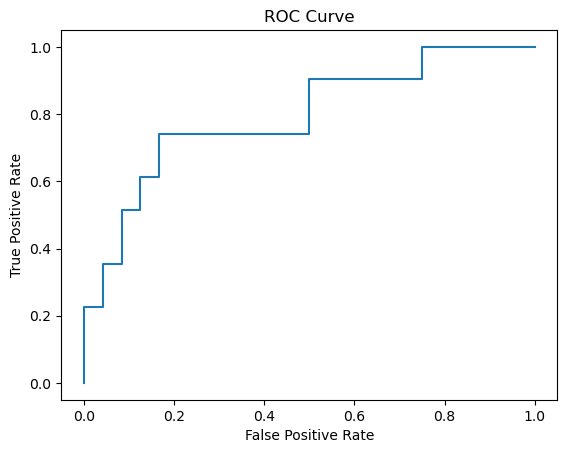

In [ ]:
from sklearn.metrics import roc_curve , roc_auc_score
y_pred_probas = model.predict(Xwords_test)
y_pred_probas = [i[0] for i in y_pred_probas]
fpr, tpr, thresholds = roc_curve(y_seq_test, y_pred_probas, pos_label = 'dementia')
# roc_auc = roc_auc_score(y_test, scores)
plt.plot(fpr, tpr)

plt.title("ROC Curve")

plt.xlabel("False Positive Rate")

plt.ylabel("True Positive Rate")

plt.show()

In [ ]:
#predicting classes on test data
from sklearn.metrics import f1_score
predict_x=model.predict(Xwords_test)

score = []
for theshold in np.arange(0,1,.01):
    classes_x= (predict_x >= theshold).astype(int)
    ideal_score = f1_score(y_nums_test, classes_x)

    score.append(ideal_score)

final = np.argmax(score)
final = final/100

print(final)



0.32


In [ ]:

classes_x = (predict_x >= final).astype(int)

In [ ]:
from sklearn.metrics import confusion_matrix
from sklearn.metrics import precision_recall_fscore_support, classification_report

print(confusion_matrix(y_nums_test, classes_x))
print(classification_report(y_nums_test, classes_x))

[[12 12]
 [ 3 28]]
              precision    recall  f1-score   support

           0       0.80      0.50      0.62        24
           1       0.70      0.90      0.79        31

    accuracy                           0.73        55
   macro avg       0.75      0.70      0.70        55
weighted avg       0.74      0.73      0.71        55



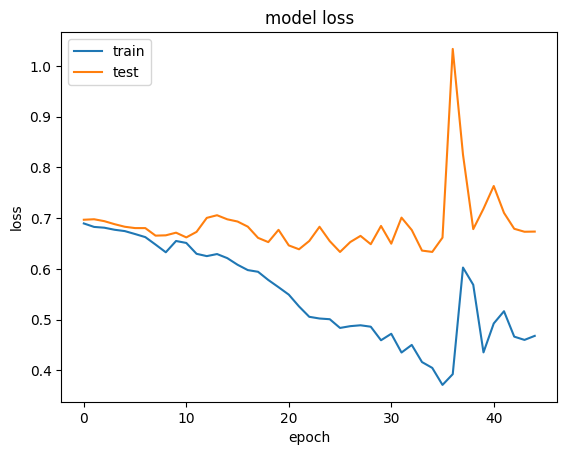

In [ ]:
plt.plot(history.history['loss'])
plt.plot(history.history['val_loss'])
plt.title('model loss')
plt.ylabel('loss')
plt.xlabel('epoch')
plt.legend(['train', 'test'], loc='upper left')
plt.show()

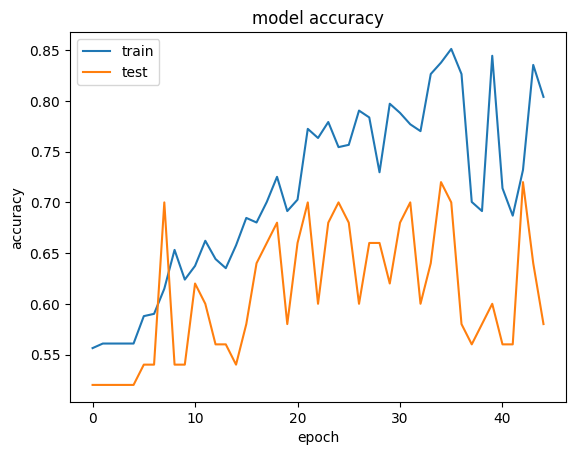

In [ ]:
plt.plot(history.history['accuracy'])
plt.plot(history.history['val_accuracy'])
plt.title('model accuracy')
plt.ylabel('accuracy')
plt.xlabel('epoch')
plt.legend(['train', 'test'], loc='upper left')
plt.show()

## BERT BiLSTM

In [ ]:

history = History()
model_bilstm = Sequential()
model_bilstm.add(Embedding(input_dim = tokenizer.vocab_size, output_dim = 768, weights = [embedding_matrix], input_length=250, trainable = False))
model_bilstm.add(Bidirectional(LSTM(128, recurrent_dropout=0.2)))
model_bilstm.add(Dense(1, activation='sigmoid'))
model_bilstm.compile(loss='binary_crossentropy', optimizer='adam', metrics=['accuracy'])
print(model_bilstm.summary())


Model: "sequential_9"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 embedding_9 (Embedding)     (None, 250, 768)          23440896  
                                                                 
 bidirectional_1 (Bidirectio  (None, 256)              918528    
 nal)                                                            
                                                                 
 dense_9 (Dense)             (None, 1)                 257       
                                                                 
Total params: 24,359,681
Trainable params: 918,785
Non-trainable params: 23,440,896
_________________________________________________________________
None


In [ ]:
import os
import tensorflow as tf

checkpoint_path = r"bert_bilstm"
checkpoint_dir = os.path.dirname(checkpoint_path)

# Create a callback that saves the model's weights
cp_callback = tf.keras.callbacks.ModelCheckpoint(filepath=checkpoint_path,
                                                 monitor="val_loss",
                                                 save_best_only=True,
                                                 save_weights_only=True,
                                                 verbose=1)

# Train the model with the new callback
model_bilstm.fit(Xwords_train, y_nums_train, epochs=45, batch_size=256,verbose = 1,callbacks = [history, cp_callback],validation_split=0.1)  # Pass callback to training


In [ ]:
# Loads the weights
model_bilstm.load_weights(checkpoint_path)

# Re-evaluate the model
loss, acc = model_bilstm.evaluate(Xwords_test, y_nums_test, verbose=2)
print("Restored model, accuracy: {:5.2f}%".format(100 * acc))

2/2 - 0s - loss: 0.6059 - accuracy: 0.6909 - 292ms/epoch - 146ms/step
Restored model, accuracy: 69.09%


2/2 [==============================] - 1s 149ms/step


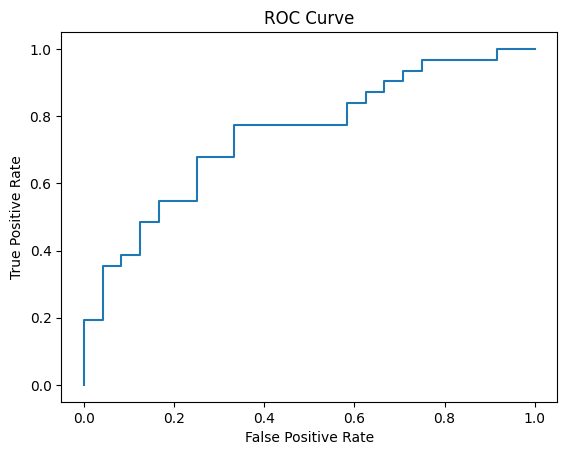

In [ ]:
from sklearn.metrics import roc_curve , roc_auc_score
y_pred_probas = model_bilstm.predict(Xwords_test)
y_pred_probas = [i[0] for i in y_pred_probas]
fpr, tpr, thresholds = roc_curve(y_seq_test, y_pred_probas, pos_label = 'dementia')
#roc_auc = roc_auc_score(y_test, scores)
plt.plot(fpr, tpr)

plt.title("ROC Curve")

plt.xlabel("False Positive Rate")

plt.ylabel("True Positive Rate")

plt.show()

In [ ]:
#predicting classes on test data
from sklearn.metrics import f1_score
predict_x=model_bilstm.predict(Xwords_test)

score = []
for theshold in np.arange(0,1,.01):
    classes_x= (predict_x >= theshold).astype(int)
    ideal_score = f1_score(y_nums_test, classes_x)

    score.append(ideal_score)

final = np.argmax(score)

print(final)


2/2 [==============================] - 0s 144ms/step
19


In [ ]:
final = final/100
classes_x = (predict_x >= final).astype(int)

In [ ]:
from sklearn.metrics import confusion_matrix
from sklearn.metrics import precision_recall_fscore_support, classification_report

print(confusion_matrix(y_nums_test, classes_x))
print(classification_report(y_nums_test, classes_x))

[[ 6 18]
 [ 1 30]]
              precision    recall  f1-score   support

           0       0.86      0.25      0.39        24
           1       0.62      0.97      0.76        31

    accuracy                           0.65        55
   macro avg       0.74      0.61      0.57        55
weighted avg       0.73      0.65      0.60        55



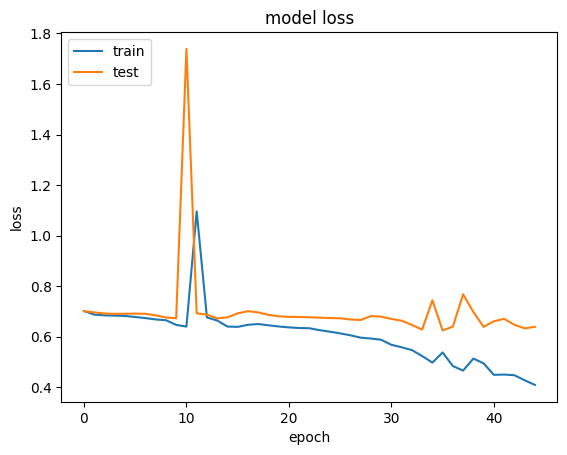

In [ ]:
plt.plot(history.history['loss'])
plt.plot(history.history['val_loss'])
plt.title('model loss')
plt.ylabel('loss')
plt.xlabel('epoch')
plt.legend(['train', 'test'], loc='upper left')
plt.show()

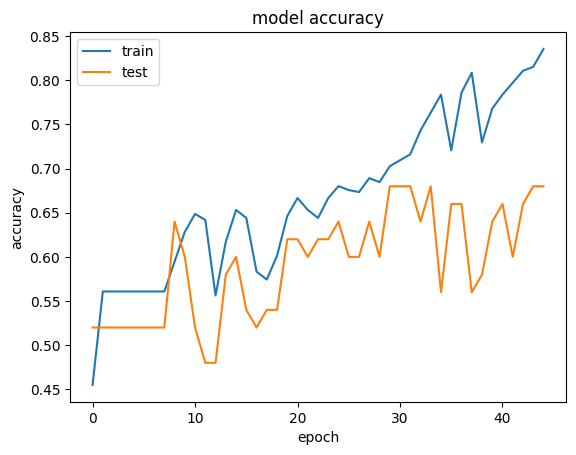

In [ ]:
plt.plot(history.history['accuracy'])
plt.plot(history.history['val_accuracy'])
plt.title('model accuracy')
plt.ylabel('accuracy')
plt.xlabel('epoch')
plt.legend(['train', 'test'], loc='upper left')
plt.show()

## BERT CNN LSTM

In [ ]:
history = History()
def create_conv_model():
    model_conv = Sequential()
    model_conv.add(Embedding(input_dim = tokenizer.vocab_size, output_dim = 768, weights = [embedding_matrix], input_length=250, trainable = False))
    model_conv.add(Dropout(0.1))
    model_conv.add(Conv1D(32, 5, activation='relu'))
    model_conv.add(MaxPooling1D(pool_size=4))
    model_conv.add(LSTM(64))
    model_conv.add(Dense(1, activation='sigmoid'))
    model_conv.compile(loss='binary_crossentropy', optimizer='adam',metrics=['accuracy'])
    return model_conv

In [ ]:
import os
import tensorflow as tf

checkpoint_path = r"bert_cnnlstm"
checkpoint_dir = os.path.dirname(checkpoint_path)

# Create a callback that saves the model's weights
cp_callback = tf.keras.callbacks.ModelCheckpoint(filepath=checkpoint_path, monitor="val_loss", save_best_only=True,
                                                 save_weights_only=True,
                                                 verbose=1)

# Train the model with the new callback

model_conv = create_conv_model()
model_conv.fit(Xwords_train, y_nums_train, epochs=45, batch_size=256,verbose = 1,callbacks = [history, cp_callback],validation_split=0.1)  # Pass callback to training



In [ ]:
# Loads the weights
model_conv.load_weights(checkpoint_path)

# Re-evaluate the model
loss, acc = model_conv.evaluate(Xwords_test, y_nums_test, verbose=2)
print("Restored model, accuracy: {:5.2f}%".format(100 * acc))

2/2 - 0s - loss: 0.4162 - accuracy: 0.8727 - 30ms/epoch - 15ms/step
Restored model, accuracy: 87.27%


2/2 [==============================] - 0s 6ms/step


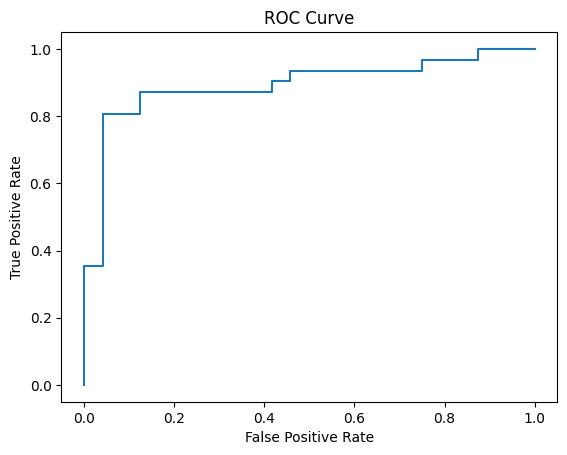

In [ ]:
from sklearn.metrics import roc_curve , roc_auc_score
y_pred_probas = model_conv.predict(Xwords_test)
y_pred_probas = [i[0] for i in y_pred_probas]
fpr, tpr, thresholds = roc_curve(y_seq_test, y_pred_probas, pos_label = 'dementia')
#roc_auc = roc_auc_score(y_test, scores)
plt.plot(fpr, tpr)

plt.title("ROC Curve")

plt.xlabel("False Positive Rate")

plt.ylabel("True Positive Rate")

plt.show()

In [ ]:
#predicting classes on test data
from sklearn.metrics import f1_score
predict_x=model_conv.predict(Xwords_test)

score = []
for theshold in np.arange(0,1,.01):
    classes_x= (predict_x >= theshold).astype(int)
    ideal_score = f1_score(y_nums_test, classes_x)

    score.append(ideal_score)

final = np.argmax(score)

print(final)


2/2 [==============================] - 0s 6ms/step
41


In [ ]:
final = final/100
classes_x = (predict_x >= final).astype(int)

In [ ]:
from sklearn.metrics import confusion_matrix
from sklearn.metrics import precision_recall_fscore_support, classification_report

print(confusion_matrix(y_nums_test, classes_x))
print(classification_report(y_nums_test, classes_x))

[[21  3]
 [ 4 27]]
              precision    recall  f1-score   support

           0       0.84      0.88      0.86        24
           1       0.90      0.87      0.89        31

    accuracy                           0.87        55
   macro avg       0.87      0.87      0.87        55
weighted avg       0.87      0.87      0.87        55



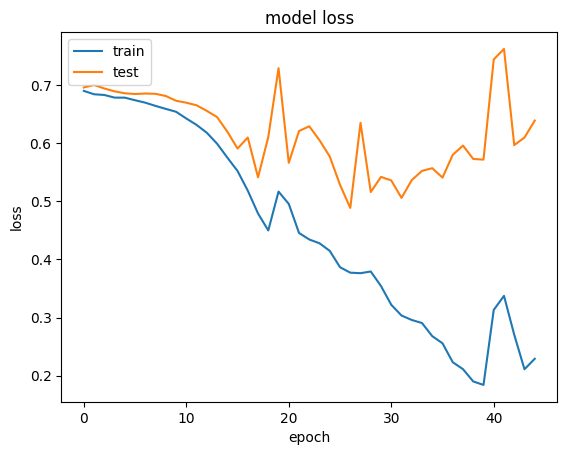

In [ ]:
plt.plot(history.history['loss'])
plt.plot(history.history['val_loss'])
plt.title('model loss')
plt.ylabel('loss')
plt.xlabel('epoch')
plt.legend(['train', 'test'], loc='upper left')
plt.show()

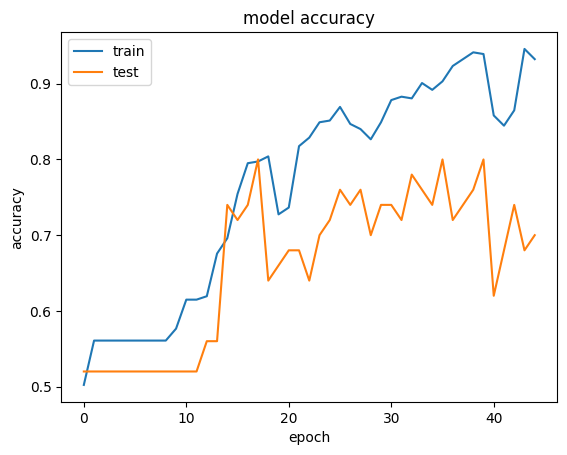

In [ ]:
plt.plot(history.history['accuracy'])
plt.plot(history.history['val_accuracy'])
plt.title('model accuracy')
plt.ylabel('accuracy')
plt.xlabel('epoch')
plt.legend(['train', 'test'], loc='upper left')
plt.show()

# FEATURE IMPORTANCE ON TOP DEEP LEARNING MODELS

doc2vec LSTM

In [ ]:
model = Sequential()
model.add(Embedding(embedding_matrix.shape[0], output_dim = 100, weights = [embedding_matrix], input_length=100, trainable = False))
model.add(LSTM(128, dropout=0.2, recurrent_dropout=0.2))
model.add(Dense(1, activation='sigmoid'))

In [ ]:
# Loads the weights
checkpoint_path = 'doc_lstm'
model.load_weights(checkpoint_path)

In [ ]:
model.compile(tf.keras.optimizers.legacy.Adam(), run_eagerly=True)

In [ ]:
# model = Sequential()
# model.add(Embedding(embedding_matrix.shape[0], output_dim = 100, weights = [embedding_matrix], input_length=100, trainable = False))
# model.add(LSTM(128, dropout=0.2, recurrent_dropout=0.2))
# model.add(Dense(1, activation='sigmoid'))
# model.compile(loss='binary_crossentropy', optimizer='adam', metrics=['accuracy'])
# print(model.summary())

In [ ]:
model.load_weights(r'C:\Users\cobus\Desktop\Thesis\Best Models\doc_lstm')

In [ ]:
!pip install shap

In [ ]:
# Xwords_test[:10]

In [ ]:
tf.__version__

'2.14.1'

In [ ]:
# from tensorflow.python.framework.ops import enable_eager_execution
# enable_eager_execution()

In [ ]:
tf.executing_eagerly()

True

In [ ]:
# model.compile(run_eagerly=True)

In [ ]:
Xwords_test.shape

(55, 100)

In [ ]:
import shap

# we use the first 100 training examples as our background dataset to integrate over
explainer = shap.Explainer(model, Xwords_train[:75])

# explain the first 10 predictions
# explaining each prediction requires 2 * background dataset size runs
shap_values = explainer.shap_values(Xwords_test[:10])

PermutationExplainer explainer: 11it [07:51, 47.20s/it]


In [ ]:
# dir(explainer)
# explainer.explain_row(Xwords_test[0])

In [ ]:
# init the JS visualization code
shap.initjs()

words = tokenizer.word_index
num2word = {}
for w in words.keys():
    num2word[words[w]] = w
x_test_words = np.stack(
    [
        np.array(list(map(lambda x: num2word.get(x, "NONE"), Xwords_test[i])))
        for i in range(10)
    ]
)

# plot the explanation of the first prediction
# Note the model is "multi-output" because it is rank-2 but only has one column
shap.force_plot(explainer.expected_value[0], shap_values[0][0], x_test_words[0])

In [ ]:
row = 22
print("actual class is", y_seq_test.iloc[22])
# X_words_test = pd.DataFrame(X_test, columns=vectorizer.get_feature_names_out())
choosen_instance = X_seq_test.iloc[row]
shap_values = explainer.shap_values(choosen_instance)
shap.initjs()
shap.plots.force(explainer.expected_value[0], shap_values[:, :], choosen_instance, matplotlib=True)

## Integrated Gradients

In [ ]:
!pip install alibi[tensorflow]

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 522.1/522.1 kB 3.2 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 116.3/116.3 kB 12.1 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 3.1/3.1 MB 27.0 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 489.9/489.9 MB 1.1 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 98.5/98.5 MB 1.5 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 5.5/5.5 MB 1.5 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 440.7/440.7 kB 1.7 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 1.7/1.7 MB 1.9 MB/s eta 0:00:00
  Attempting uninstall: tensorflow-estimator
    Found existing installation: tensorflow-estimator 2.15.0
    Uninstalling tensorflow-estimator-2.15.0:
      Successfully uninstalled tensorflow-estimator-2.15.0
  Attempting uninstall: pydantic
    Found existing installation: pydantic 2.6.4
    Uninstalling pydantic-2.6.4:
      Successfully uninstalled 

1/1 [==============================] - 2s 2s/step


In [ ]:
# model.layers[0]

In [ ]:
from alibi.explainers import IntegratedGradients

n_steps = 20
method = "gausslegendre"
internal_batch_size = 100
ig  = IntegratedGradients(model,
                          layer=model.layers[0],
                          n_steps=n_steps,
                          method=method,
                          internal_batch_size=internal_batch_size)
preds = np.around(model.predict(Xwords_test)).astype(int).reshape(-1)
explanation = ig.explain(Xwords_test, target=preds)
# explanation = ig.explain(Xwords_test, target=y_nums_test)

In [ ]:
len(explanation.attributions)

1

In [ ]:
# If 4 dimensions, (1, # of observations, sequence length, embedding size)
# If 3 dimensions, (1, sequence length, embedding size)
attrs = np.array(explanation.attributions)
attrs = attrs.sum(axis=3)

print('Attributions shape:', attrs.shape)

In [ ]:
from IPython.display import HTML
def  hlstr(string, color='white'):
    """
    Return HTML markup highlighting text with the desired color.
    """
    return f"<mark style=background-color:{color}>{string} </mark>"


def colorize(attrs, cmap='PiYG'):
    """
    Compute hex colors based on the attributions for a single instance.
    Uses a diverging colorscale by default and normalizes and scales
    the colormap so that colors are consistent with the attributions.
    """
    import matplotlib as mpl
    cmap_bound = np.abs(attrs).max()
    norm = mpl.colors.Normalize(vmin=-cmap_bound, vmax=cmap_bound)
    cmap = mpl.cm.get_cmap(cmap)

    # now compute hex values of colors
    colors = list(map(lambda x: mpl.colors.rgb2hex(cmap(norm(x))), attrs))
    return colors

In [ ]:
row_num = 9 # 9, 50, 2, 7, 11, 13, 33
words = tokenizer.sequences_to_texts(Xwords_test[[row_num]])[0].split()
colors = colorize(attrs[0, row_num])

<ipython-input-99-6faf338aa0bf>:18: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed two minor releases later. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap(obj)`` instead.
  cmap = mpl.cm.get_cmap(cmap)


In [ ]:
print('Actual label =  {}: {}'.format(y_nums_test.iloc[row_num], y_seq_test.iloc[row_num]))
print('Predicted label =  {}: {}'.format(preds[row_num], ('control', 'dementia')[preds[row_num]]))

Actual label =  1: dementia
Predicted label =  1: dementia


In [ ]:
HTML("".join(list(map(hlstr, words, colors))))

In [ ]:
row_num = 50 # 9, 50, 2, 7, 11, 13, 33
words = tokenizer.sequences_to_texts(Xwords_test[[row_num]])[0].split()
colors = colorize(attrs[0, row_num])

print('Actual label =  {}: {}'.format(y_nums_test.iloc[row_num], y_seq_test.iloc[row_num]))
print('Predicted label =  {}: {}'.format(preds[row_num], ('control', 'dementia')[preds[row_num]]))

display(HTML(f'whole text: {X_seq_test.iloc[row_num]}'))
HTML("".join(list(map(hlstr, words, colors))))

Actual label =  0: control
Predicted label =  0: control


<ipython-input-99-6faf338aa0bf>:18: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed two minor releases later. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap(obj)`` instead.
  cmap = mpl.cm.get_cmap(cmap)


In [ ]:
len(X_seq_test.iloc[row_num].split())

351

In [ ]:
row_num = 2 # 9, 50, 2, 7, 11, 13, 33
words = tokenizer.sequences_to_texts(Xwords_test[[row_num]])[0].split()
colors = colorize(attrs[0, row_num])
print('Actual label =  {}: {}'.format(y_nums_test.iloc[row_num], y_seq_test.iloc[row_num]))
print('Predicted label =  {}: {}'.format(preds[row_num], ('control', 'dementia')[preds[row_num]]))
display(HTML(f'whole text: {X_seq_test.iloc[row_num]}'))
HTML("".join(list(map(hlstr, words, colors))))

Actual label =  0: control
Predicted label =  0: control


<ipython-input-99-6faf338aa0bf>:18: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed two minor releases later. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap(obj)`` instead.
  cmap = mpl.cm.get_cmap(cmap)


In [ ]:
row_num = 7 # 9, 50, 2, 7, 11, 13, 33
words = tokenizer.sequences_to_texts(Xwords_test[[row_num]])[0].split()
colors = colorize(attrs[0, row_num])
print('Actual label =  {}: {}'.format(y_nums_test.iloc[row_num], y_seq_test.iloc[row_num]))
print('Predicted label =  {}: {}'.format(preds[row_num], ('control', 'dementia')[preds[row_num]]))
display(HTML(f'whole text: {X_seq_test.iloc[row_num]}'))
HTML("".join(list(map(hlstr, words, colors))))

Actual label =  1: dementia
Predicted label =  1: dementia


<ipython-input-99-6faf338aa0bf>:18: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed two minor releases later. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap(obj)`` instead.
  cmap = mpl.cm.get_cmap(cmap)


In [ ]:
row_num = 11 # 9, 50, 2, 7, 11, 13, 33
words = tokenizer.sequences_to_texts(Xwords_test[[row_num]])[0].split()
colors = colorize(attrs[0, row_num])
print('Actual label =  {}: {}'.format(y_nums_test.iloc[row_num], y_seq_test.iloc[row_num]))
print('Predicted label =  {}: {}'.format(preds[row_num], ('control', 'dementia')[preds[row_num]]))
display(HTML(f'whole text: {X_seq_test.iloc[row_num]}'))
HTML("".join(list(map(hlstr, words, colors))))

Actual label =  1: dementia
Predicted label =  1: dementia


<ipython-input-99-6faf338aa0bf>:18: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed two minor releases later. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap(obj)`` instead.
  cmap = mpl.cm.get_cmap(cmap)


In [ ]:
row_num = 13 # 9, 50, 2, 7, 11, 13, 33
words = tokenizer.sequences_to_texts(Xwords_test[[row_num]])[0].split()
colors = colorize(attrs[0, row_num])
print('Actual label =  {}: {}'.format(y_nums_test.iloc[row_num], y_seq_test.iloc[row_num]))
print('Predicted label =  {}: {}'.format(preds[row_num], ('control', 'dementia')[preds[row_num]]))
display(HTML(f'whole text: {X_seq_test.iloc[row_num]}'))
HTML("".join(list(map(hlstr, words, colors))))

Actual label =  1: dementia
Predicted label =  0: control


<ipython-input-99-6faf338aa0bf>:18: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed two minor releases later. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap(obj)`` instead.
  cmap = mpl.cm.get_cmap(cmap)


In [ ]:
row_num = 33 # 9, 50, 2, 7, 11, 13, 33
words = tokenizer.sequences_to_texts(Xwords_test[[row_num]])[0].split()
colors = colorize(attrs[0, row_num])
print('Actual label =  {}: {}'.format(y_nums_test.iloc[row_num], y_seq_test.iloc[row_num]))
print('Predicted label =  {}: {}'.format(preds[row_num], ('control', 'dementia')[preds[row_num]]))
display(HTML(f'whole text: {X_seq_test.iloc[row_num]}'))
HTML("".join(list(map(hlstr, words, colors))))

Actual label =  1: dementia
Predicted label =  1: dementia


<ipython-input-99-6faf338aa0bf>:18: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed two minor releases later. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap(obj)`` instead.
  cmap = mpl.cm.get_cmap(cmap)


In [ ]:
GE = shap.GradientExplainer(model_conv, Xwords_train.reshape((494, 100))) # X_train is 3d numpy.ndarray
shap_values = GE.shap_values(Xwords_test.reshape((55, 100))) # X_validate is 3d numpy.ndarray

In [ ]:
import shap
# wrap = Sequential()
# for layer in model.layers:
#   wrap.add_layer(layer)
GE = shap.GradientExplainer(model_conv, Xwords_train.reshape((494, 100))) # X_train is 3d numpy.ndarray
shap_values = GE.shap_values(Xwords_test.reshape((55, 100))) # X_validate is 3d numpy.ndarray

shap.initjs()
shap.summary_plot(
    shap_values[0],
    X_validate,
    feature_names=list_of_your_columns_here,
    max_display=50,
    plot_type='bar')


In [ ]:
from tensorflow.compat.v1.keras.backend import get_session
tf.compat.v1.disable_v2_behavior()

import tensorflow.compat.v1.keras.backend as K
import tensorflow as tf
tf.compat.v1.disable_eager_execution()

In [ ]:
# Use the training data for deep explainer => can use fewer instances
explainer = shap.GradientExplainer(model, Xwords_train)
# explain the the testing instances (can use fewer instanaces)
# explaining each prediction requires 2 * background dataset size runs
shap_values = explainer.shap_values(Xwords_test)
# init the JS visualization code
shap.initjs()
shap.force_plot(explainer.expected_value[0], shap_values[0][0], features)

In [ ]:
import shap

# we use the first 100 training examples as our background dataset to integrate over
explainer = shap.GradientExplainer(model, Xwords_train[:100])

# explain the first 10 predictions
# explaining each prediction requires 2 * background dataset size runs
shap_values = explainer.shap_values(Xwords_test[:10])

## Feature importance with LIME

### Doc2Vec LSTM

In [ ]:
model = Sequential()
model.add(Embedding(embedding_matrix.shape[0], output_dim = 100, weights = [embedding_matrix], input_length=100, trainable = False))
model.add(LSTM(128, dropout=0.2, recurrent_dropout=0.2))
model.add(Dense(1, activation='sigmoid'))

In [ ]:
# checkpoint_path = r"doc_lstm"
# model.load_weights(checkpoint_path)
# model.save_weights('Best Models/doc_lstm')

In [ ]:
model.load_weights(r'C:\Users\cobus\Desktop\Thesis\Best Models\Best Models\doc_lstm')

In [ ]:
#predicting classes on test data
from sklearn.metrics import f1_score
predict_x=model.predict(Xwords_test)

score = []
for theshold in np.arange(0,1,.01):
    classes_x= (predict_x >= theshold).astype(int)
    ideal_score = f1_score(y_nums_test, classes_x)

    score.append(ideal_score)

final = np.argmax(score)
final = final/100
print(final)

classes_x = (predict_x >= final).astype(int)

from sklearn.metrics import confusion_matrix
from sklearn.metrics import precision_recall_fscore_support, classification_report

print(confusion_matrix(y_nums_test, classes_x))
print(classification_report(y_nums_test, classes_x))

0.38
[[21  3]
 [ 6 25]]
              precision    recall  f1-score   support

           0       0.78      0.88      0.82        24
           1       0.89      0.81      0.85        31

    accuracy                           0.84        55
   macro avg       0.84      0.84      0.84        55
weighted avg       0.84      0.84      0.84        55



In [ ]:
from lime.lime_text import LimeTextExplainer
class_names=['control','dementia']
explainer= LimeTextExplainer(class_names=class_names)

def predict_proba(arr):
  list_tokenized_ex = tokenizer.texts_to_sequences(arr)
  seqs = pad_sequences(list_tokenized_ex, maxlen=max_review_length)
  preds = model.predict(seqs)
  returnable = []
  for pred in preds:
    temp = pred[0]
    returnable.append(np.array([1-temp, temp])) #I would recommend rounding temp and 1-temp off to 2 places

  return np.array(returnable)


In [ ]:
# print("Actual text:", X_seq_test.iloc[50])
print("Actual class:", y_seq_test.iloc[50])

explainer.explain_instance(X_seq_test.iloc[50], predict_proba).show_in_notebook(text=True)

Actual class: control


In [ ]:

print("Actual class:", y_seq_test.iloc[2])

explainer.explain_instance(X_seq_test.iloc[2], predict_proba).show_in_notebook(text=True)

Actual class: control


In [ ]:

print("Actual class:", y_seq_test.iloc[7])

explainer.explain_instance(X_seq_test.iloc[7], predict_proba).show_in_notebook(text=True)

Actual class: dementia


In [ ]:

print("Actual class:", y_seq_test.iloc[11])

explainer.explain_instance(X_seq_test.iloc[11], predict_proba).show_in_notebook(text=True)

Actual class: dementia


### doc2vec bilstm

In [ ]:
model_bilstm.load_weights(r'C:\Users\cobus\Desktop\Thesis\Best Models\Best Models\doc_bilstm')

In [ ]:
#predicting classes on test data
from sklearn.metrics import f1_score
predict_x=model_bilstm.predict(Xwords_test)

score = []
for theshold in np.arange(0,1,.01):
    classes_x= (predict_x >= theshold).astype(int)
    ideal_score = f1_score(y_nums_test, classes_x)

    score.append(ideal_score)

final = np.argmax(score)
final = final/100
print(final)

classes_x = (predict_x >= final).astype(int)

from sklearn.metrics import confusion_matrix
from sklearn.metrics import precision_recall_fscore_support, classification_report

print(confusion_matrix(y_nums_test, classes_x))
print(classification_report(y_nums_test, classes_x))

0.5
[[24  0]
 [ 6 25]]
              precision    recall  f1-score   support

           0       0.80      1.00      0.89        24
           1       1.00      0.81      0.89        31

    accuracy                           0.89        55
   macro avg       0.90      0.90      0.89        55
weighted avg       0.91      0.89      0.89        55



In [ ]:
from lime.lime_text import LimeTextExplainer
class_names=['control','dementia']
explainer= LimeTextExplainer(class_names=class_names)

def predict_proba(arr):
  list_tokenized_ex = tokenizer.texts_to_sequences(arr)
  seqs = pad_sequences(list_tokenized_ex, maxlen=max_review_length)
  preds = model_bilstm.predict(seqs)
  returnable = []
  for pred in preds:
    temp = pred[0]
    returnable.append(np.array([1-temp, temp])) #I would recommend rounding temp and 1-temp off to 2 places

  return np.array(returnable)


In [ ]:

print("Actual class:", y_seq_test.iloc[50])

explainer.explain_instance(X_seq_test.iloc[50], predict_proba).show_in_notebook(text=True)

Actual class: control


In [ ]:

print("Actual class:", y_seq_test.iloc[2])

explainer.explain_instance(X_seq_test.iloc[2], predict_proba).show_in_notebook(text=True)

Actual class: control


In [ ]:

print("Actual class:", y_seq_test.iloc[7])

explainer.explain_instance(X_seq_test.iloc[7], predict_proba).show_in_notebook(text=True)

Actual class: dementia


In [ ]:

print("Actual class:", y_seq_test.iloc[11])

explainer.explain_instance(X_seq_test.iloc[11], predict_proba).show_in_notebook(text=True)

Actual class: dementia


### doc2vec cnn-lstm

In [ ]:
model_conv1.load_weights(r'C:\Users\cobus\Desktop\Thesis\Best Models\Best Models\doc_cnnlstm')

In [ ]:
#predicting classes on test data
from sklearn.metrics import f1_score
predict_x=model_conv1.predict(Xwords_test)

score = []
for theshold in np.arange(0,1,.01):
    classes_x= (predict_x >= theshold).astype(int)
    ideal_score = f1_score(y_nums_test, classes_x)

    score.append(ideal_score)

final = np.argmax(score)
final = final/100
print(final)

classes_x = (predict_x >= final).astype(int)

from sklearn.metrics import confusion_matrix
from sklearn.metrics import precision_recall_fscore_support, classification_report

print(confusion_matrix(y_nums_test, classes_x))
print(classification_report(y_nums_test, classes_x))

C:\Users\cobus\AppData\Roaming\Python\Python39\site-packages\keras\engine\training_v1.py:2359: UserWarning: `Model.state_updates` will be removed in a future version. This property should not be used in TensorFlow 2.0, as `updates` are applied automatically.
  updates=self.state_updates,


0.27
[[18  6]
 [ 1 30]]
              precision    recall  f1-score   support

           0       0.95      0.75      0.84        24
           1       0.83      0.97      0.90        31

    accuracy                           0.87        55
   macro avg       0.89      0.86      0.87        55
weighted avg       0.88      0.87      0.87        55



In [ ]:
from lime.lime_text import LimeTextExplainer
class_names=['control','dementia']
explainer= LimeTextExplainer(class_names=class_names)

def predict_proba(arr):
  list_tokenized_ex = tokenizer.texts_to_sequences(arr)
  seqs = pad_sequences(list_tokenized_ex, maxlen=max_review_length)
  preds = model_conv1.predict(seqs)
  returnable = []
  for pred in preds:
    temp = pred[0]
    returnable.append(np.array([1-temp, temp])) #I would recommend rounding temp and 1-temp off to 2 places

  return np.array(returnable)


In [ ]:

print("Actual class:", y_seq_test.iloc[50])

explainer.explain_instance(X_seq_test.iloc[50], predict_proba).show_in_notebook(text=True)

Actual class: control


In [ ]:

print("Actual class:", y_seq_test.iloc[2])

explainer.explain_instance(X_seq_test.iloc[2], predict_proba).show_in_notebook(text=True)

Actual class: control


In [ ]:

print("Actual class:", y_seq_test.iloc[7])

explainer.explain_instance(X_seq_test.iloc[7], predict_proba).show_in_notebook(text=True)

Actual class: dementia


In [ ]:

print("Actual class:", y_seq_test.iloc[11])

explainer.explain_instance(X_seq_test.iloc[11], predict_proba).show_in_notebook(text=True)

Actual class: dementia


In [ ]:

print("Actual class:", y_seq_test.iloc[33])

explainer.explain_instance(X_seq_test.iloc[33], predict_proba).show_in_notebook(text=True)

Actual class: dementia


In [ ]:

print("Actual class:", y_seq_test.iloc[13])

explainer.explain_instance(X_seq_test.iloc[13], predict_proba).show_in_notebook(text=True)

Actual class: dementia


### bert cnn-lstm

In [ ]:
model_conv.load_weights(r'C:\Users\cobus\Desktop\Thesis\Best Models\bert_cnnlstm')

In [ ]:
pip show transformers

Note: you may need to restart the kernel to use updated packages.


Name: transformers
Version: 4.28.1
Summary: State-of-the-art Machine Learning for JAX, PyTorch and TensorFlow
Home-page: https://github.com/huggingface/transformers
Author: The Hugging Face team (past and future) with the help of all our contributors (https://github.com/huggingface/transformers/graphs/contributors)
Author-email: transformers@huggingface.co
License: Apache 2.0 License
Location: c:\users\cobus\anaconda3\lib\site-packages
Requires: filelock, huggingface-hub, numpy, packaging, pyyaml, regex, requests, tokenizers, tqdm
Required-by: sentence-transformers


In [ ]:
#predicting classes on test data
from sklearn.metrics import f1_score
predict_x=model_conv.predict(Xwords_test)

score = []
for theshold in np.arange(0,1,.01):
    classes_x= (predict_x >= theshold).astype(int)
    ideal_score = f1_score(y_nums_test, classes_x)

    score.append(ideal_score)

final = np.argmax(score)
final = final/100
print(final)

classes_x = (predict_x >= final).astype(int)

from sklearn.metrics import confusion_matrix
from sklearn.metrics import precision_recall_fscore_support, classification_report

print(confusion_matrix(y_nums_test, classes_x))
print(classification_report(y_nums_test, classes_x))

C:\Users\cobus\AppData\Roaming\Python\Python39\site-packages\keras\engine\training_v1.py:2359: UserWarning: `Model.state_updates` will be removed in a future version. This property should not be used in TensorFlow 2.0, as `updates` are applied automatically.
  updates=self.state_updates,


0.38
[[19  5]
 [ 3 28]]
              precision    recall  f1-score   support

           0       0.86      0.79      0.83        24
           1       0.85      0.90      0.88        31

    accuracy                           0.85        55
   macro avg       0.86      0.85      0.85        55
weighted avg       0.86      0.85      0.85        55



In [ ]:
from lime.lime_text import LimeTextExplainer
class_names=['control','dementia']
explainer= LimeTextExplainer(class_names=class_names)

def predict_proba(arr):
    input_ids = []

    # For every sentence...
    for sent in arr:
        encoded_dict = tokenizer.encode_plus(
                sent,                      # Sentence to split into tokens
                add_special_tokens = True, # Add special token '[CLS]' and '[SEP]'
                padding = 'longest',
                return_attention_mask = True,   # Construct attention masks.
                return_tensors = 'pt',     # Return pytorch tensors.
            )
        new_input_ids = encoded_dict['input_ids'].reshape((-1,)).detach().numpy()
        input_ids.append(new_input_ids)

    seqs = pad_sequences(input_ids, maxlen=250) # 250
    preds = model_conv.predict(seqs)
    returnable = []
    for pred in preds:
        temp = pred[0]
        returnable.append([1-temp, temp])
    return np.array(returnable)

In [ ]:
# dir(tokenizer)

In [ ]:

print("Actual class:", y_seq_test.iloc[50])
explainer.explain_instance(X_seq_test.iloc[50], predict_proba).show_in_notebook(text=True)

Actual class: control


In [ ]:

print("Actual class:", y_seq_test.iloc[2])

explainer.explain_instance(X_seq_test.iloc[2], predict_proba).show_in_notebook(text=True)

Actual class: control


In [ ]:

print("Actual class:", y_seq_test.iloc[7])

explainer.explain_instance(X_seq_test.iloc[7], predict_proba).show_in_notebook(text=True)

Actual class: dementia


In [ ]:

print("Actual class:", y_seq_test.iloc[11])

explainer.explain_instance(X_seq_test.iloc[11], predict_proba).show_in_notebook(text=True)

Actual class: dementia


In [ ]:

print("Actual class:", y_seq_test.iloc[13])

explainer.explain_instance(X_seq_test.iloc[13], predict_proba).show_in_notebook(text=True)

Actual class: dementia


In [ ]:
print("Actual class:", y_seq_test.iloc[33])

explainer.explain_instance(X_seq_test.iloc[33], predict_proba).show_in_notebook(text=True)

Actual class: dementia


## INTEGRATED GRADIENTS

#### doc2vec lstm

In [ ]:
pip install -r requirements.txt --user

Note: you may need to restart the kernel to use updated packages.Looking in indexes: https://pypi.org/simple, https://pypi.ngc.nvidia.com
     --------------------------------------- 13.3/13.3 MB 25.2 MB/s eta 0:00:00
INFO: pip is looking at multiple versions of tensorflow to determine which version is compatible with other requirements. This could take a while.
     ------------------------------------- 376.9/376.9 MB 93.0 MB/s eta 0:00:00
     ---------------------------------------- 127.7/127.7 kB ? eta 0:00:00
     ---------------------------------------- 1.1/1.1 MB 69.9 MB/s eta 0:00:00
     ------------------------------------- 300.8/300.8 MB 10.1 MB/s eta 0:00:00
     ------------------------------------- 300.8/300.8 MB 27.3 MB/s eta 0:00:00
     -------------------------------------- 284.1/284.1 MB 5.7 MB/s eta 0:00:00
     ------------------------------------ 284.1/284.1 MB 108.8 MB/s eta 0:00:00
     ------------------------------------- 938.4/938.4 kB 58.0 MB/s eta 0:00:00
 

ERROR: Could not install packages due to an OSError: [WinError 5] Access is denied: 'C:\\Users\\cobus\\AppData\\Roaming\\Python\\Python39\\site-packages\\google\\~upb\\_message.cp39-win_amd64.pyd'
Check the permissions.



In [ ]:
# Import necessary modules
import tensorflow as tf
import numpy as np
import pandas as pd
import re
from alibi.explainers import IntegratedGradients
import matplotlib as mpl


In [ ]:
model.load_weights(r'C:\Users\cobus\Desktop\Thesis\Best Models\Best Models\doc_lstm')

In [ ]:
#  Extracting the first transformer block
bl = model.layers[0]

In [ ]:
print(bl)

In [ ]:
# Define the integrated gradient method
n_steps = 20
method = "gausslegendre"
internal_batch_size = 25
ig  = IntegratedGradients(model,
                          layer=bl,
                          n_steps=n_steps,
                          method=method,
                          internal_batch_size=internal_batch_size)

In [ ]:
Xwords_test

array([[   0,    0,    0, ...,  390,   62, 1499],
       [   0,    0,    0, ...,   27,    1,  490],
       [  58,   72,   39, ...,    6,   84,   27],
       ...,
       [   0,    0,    0, ...,    7,   10,   15],
       [   0,    0,    0, ...,    2,   82,  100],
       [   0,    0,    0, ...,   84,  126,   10]])

In [ ]:
predictions = np.around(model.predict(Xwords_test)).reshape(-1).astype(int)
explanaition = ig.explain(Xwords_test,
#                           forward_kwargs=kwargs,
                          baselines=None,
                          target=predictions)